# <center>Submitted By: -</center>
### <center>1) Jeel Gondaliya - B00819827</center>
### <center>2) Sampark Pradhan - B00821733</center>

In [1]:
# Imports
import geopandas as gpd
import numpy as np
import pandas as pd
from shapely.geometry import Point
import shapely
import missingno as msn
import seaborn as sns
import matplotlib.pyplot as plt
from descartes import PolygonPatch
from shapely import wkt
from matplotlib.animation import FuncAnimation
from JSAnimation import IPython_display
from IPython.display import HTML
from IPython.display import display, clear_output
import seaborn as sns
%matplotlib inline
plt.rcParams["animation.html"] = "html5"
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Reading the AIS data into dataframe
df=pd.read_csv('AISData.csv')
df.rename(columns={"location.coordinates.0": "locationx", "location.coordinates.1": "locationy"},inplace=True)
df = df.drop(df.columns[0], axis=1)

In [3]:
# Converting the dataframe into geo datarame
gdf = gpd.GeoDataFrame(df.drop(['locationx', 'locationy'], axis=1),
crs={'init': 'epsg:4326'},
geometry=[shapely.geometry.Point(xy) for xy in zip(df.locationx, df.locationy)])
gdf.head()

,event_time,position_accuracy,mmsi,sog,cog,geometry
0,2019-04-11T09:47:30.153Z,0.0,316013808,3.0,319.500000,POINT (-63.55608166666666 44.624835)
1,2019-04-11T09:47:27.273Z,0.0,316013808,3.0,320.700012,POINT (-63.55605333333333 44.62481666666667)
2,2019-04-11T09:47:34.340Z,0.0,316013808,2.9,319.500000,POINT (-63.55613833333334 44.62486833333333)
3,2019-04-11T09:47:37.087Z,0.0,316013808,3.0,319.799988,POINT (-63.55618666666667 44.62489833333333)
4,2019-04-19T09:52:19.358Z,0.0,316013808,3.2,337.200012,POINT (-63.55599833333334 44.62488333333334)


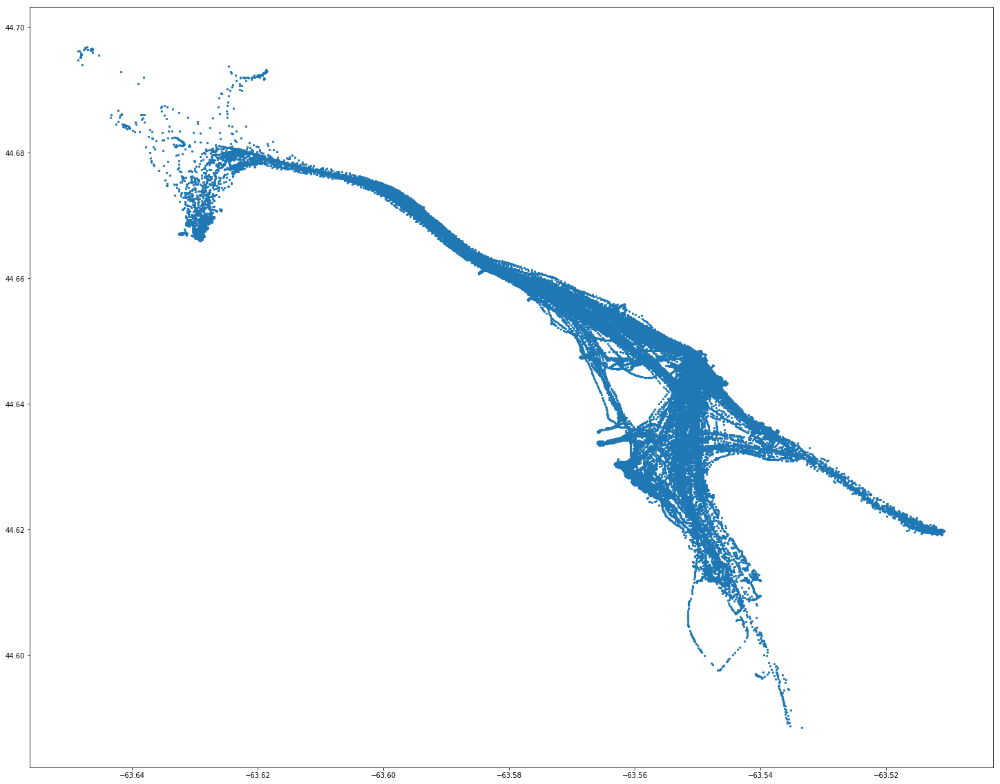

In [4]:
# Plotting all the geographical points  given in AISData.csv
ax = gdf.plot(figsize=(25,25),markersize=5)

In [5]:
# Retriving the shape file and storng it into a geo dataframe
ports = gpd.read_file('assignment3shapefile.shp')
allPorts = ports.set_index(['port_name'])
allPorts.head()

,field_1,size,geometry
port_name,,,
pointpolygon,0,0.0000,"POLYGON ((-63.59160304069519 44.6649292254607,..."
port1,1,0.0018,"POLYGON ((-63.569431 44.649993, -63.5694396674..."
port2,2,0.0018,"POLYGON ((-63.60949000000001 44.675853, -63.60..."
ind,3,0.0000,POLYGON ((-63.54742169380188 44.64697911403847...
port5,4,0.0018,"POLYGON ((-63.568048 44.663875, -63.5680566674..."


In [6]:
# Finding centroids of all polygons
allPorts['centroids'] = allPorts['geometry'].centroid
allPorts.head()

,field_1,size,geometry,centroids
port_name,,,,
pointpolygon,0,0.0000,"POLYGON ((-63.59160304069519 44.6649292254607,...",POINT (-63.5833727909049 44.65930014918037)
port1,1,0.0018,"POLYGON ((-63.569431 44.649993, -63.5694396674...",POINT (-63.57123099999995 44.64999299999998)
port2,2,0.0018,"POLYGON ((-63.60949000000001 44.675853, -63.60...",POINT (-63.61129000000003 44.67585300000001)
ind,3,0.0000,POLYGON ((-63.54742169380188 44.64697911403847...,POINT (-63.54591037582733 44.64508327592169)
port5,4,0.0018,"POLYGON ((-63.568048 44.663875, -63.5680566674...",POINT (-63.56984800000002 44.66387500000003)


## 1. Plotting buffers around each ports and findinng all AIS messages that intersect with  these ports using Join operation

In [7]:
# Creating buffers around each polygons
allPorts['buffer'] = allPorts.geometry.buffer(2)
buffers = allPorts['buffer']
buffers_final = gpd.GeoDataFrame(buffers, columns=['geometry'])

In [8]:
# Finding the AIS messages that intersect with each buffer of all the ports
joins = gpd.sjoin(gdf, allPorts, how="inner", op="within")
joins.head()

,event_time,position_accuracy,mmsi,sog,cog,geometry,index_right,field_1,size,centroids,buffer
3124,2019-06-28T09:54:52.526Z,0.0,316013808,0.1,59.700001,POINT (-63.51242666666667 44.62054166666667),auto_port,8,0.0015,POINT (-63.51099499999998 44.62011),POLYGON ((-61.51190408759074 44.71824534867709...
3125,2019-06-28T09:54:52.526Z,0.0,316013808,0.1,59.700001,POINT (-63.51242666666667 44.62054166666667),auto_port,8,0.0015,POINT (-63.51099499999998 44.62011),POLYGON ((-61.51190408759074 44.71824534867709...
3126,2019-05-18T10:18:55.155Z,0.0,316013808,0.0,24.299999,POINT (-63.51236166666666 44.62050166666667),auto_port,8,0.0015,POINT (-63.51099499999998 44.62011),POLYGON ((-61.51190408759074 44.71824534867709...
3127,2019-06-28T09:52:13.732Z,0.0,316013808,0.3,70.000000,POINT (-63.5124 44.62049666666667),auto_port,8,0.0015,POINT (-63.51099499999998 44.62011),POLYGON ((-61.51190408759074 44.71824534867709...
3128,2019-06-28T09:52:13.732Z,0.0,316013808,0.3,70.000000,POINT (-63.5124 44.62049666666667),auto_port,8,0.0015,POINT (-63.51099499999998 44.62011),POLYGON ((-61.51190408759074 44.71824534867709...


In [9]:
# Creating df for message density for each port(will be used in question 6)
countsOfPorts = joins['index_right'].value_counts()
eachPortDensity = countsOfPorts.to_frame().reset_index()
eachPortDensity

,index,index_right
0,port7,703250
1,southend container terminal,7544
2,auto_port,2068
3,Fairview cove,1481
4,po001,1445
5,oulier_maybecday,255
6,waterfront h,229
7,pointpolygon,153
8,port2,119
9,south_enterance,39


In [11]:
# Plotting all the AIS Messages which intersect with ports
fig, ax = plt.subplots(figsize=(200,200))
allPorts.plot(ax=ax, facecolor='pink');
joins.plot(ax=ax, color='black', markersize=100);
plt.tight_layout();

## 2. Density of each port on map using color scale

In [12]:
# Plotting the density of messages in each port
fig, ax = plt.subplots(figsize=(200,200))
allPorts.plot(ax=ax, facecolor='gray');
joins.plot(ax=ax, markersize=500, scheme='QUANTILES', cmap='Purples', legend=True);
plt.tight_layout();

## 3. Dividing the data into dataframes, each with one hour interval 

In [10]:
# Splitting event time
joins[['loc1','loc2']] = joins['event_time'].str.split('.', expand=True)
joins.sort_values(by='loc1', inplace=True)
joins['index_right'].unique()
joins.drop(columns=['index_right', 'field_1','size','centroids','buffer'],inplace=True)

In [11]:
# event_time into another series to create the one hour intervals
eventTimes = pd.to_datetime(joins.loc1)
list_dt= list(eventTimes)
allEventTimes = pd.Series(list_dt)

In [12]:
# Creatng list of sub dataframes conatining one hour time intervals
listOfDfs = [g.reset_index(drop=True) for i, g in joins.groupby([(allEventTimes - allEventTimes[0]).astype('timedelta64[h]')])]

### Note:- We are showing animation for 50 sub dataframes as it will take too much time to run animation for all sub dataframes(2516).

In [27]:
tempListOfDfs = []
for i in range(50):
    tempListOfDfs.append(listOfDfs[i])

### Note:-  If the animation is not visbile you might have to rerun the code again to see the animation.

In [28]:
# Showing the animation for AIS messages on each port
from IPython.display import display, clear_output

fig, ax = plt.subplots(figsize=(150, 150))
graph, = ax.plot([],[], 'o',color='blue', markersize=100)
allPorts.plot(ax=ax, facecolor='orange');

def get_dataframe_x(i):
    return tempListOfDfs[i].geometry.x

def get_dataframe_y(i):
    return tempListOfDfs[i].geometry.y

def update(i):
    x = get_dataframe_x(i)
    y = get_dataframe_y(i)
    graph.set_data(x,y)
    return graph,

ani = FuncAnimation(fig, update,frames=range(1, len(tempListOfDfs)),interval=500, blit=False)
ani

In [29]:
# Showing the animation for density of messages in each port using color coded map
from IPython.display import display, clear_output
import matplotlib.colors as colors
import matplotlib.cm as cm
fig, ax = plt.subplots(figsize=(150, 150))
allPorts.plot(ax=ax, facecolor='gray');

def get_dataframes(i):
    return tempListOfDfs[i]

def update(i):
    x = get_dataframes(i)
    graph = x.plot(ax=ax, markersize=500,scheme='QUANTILES', cmap='viridis', legend=True)
    return graph

ani = FuncAnimation(fig, update,frames=range(1, len(tempListOfDfs)),interval=500, blit=False)
ani

<Figure size 432x288 with 0 Axes>

## 4. Selecting port and creating a temporal chart

We have selected "oulier_maybecday" port. This port has 255 AIS Message density . Thus the temporal chart for the density of message in this port is clearly visible.

In [20]:
joins = gpd.sjoin(gdf, allPorts, how="inner", op="within")
oulier_maybecday = joins.loc[joins['index_right'] == 'oulier_maybecday']

# Converting the event time column to date and time format
oulier_maybecday['event_time'] = pd.to_datetime(oulier_maybecday['event_time'])
timedata = oulier_maybecday['event_time']
timedata = pd.to_datetime(timedata)

# Taking only hour information from event_time column
timedata = timedata.apply(lambda x: x.hour)
timedata = timedata.to_frame().reset_index()
timedata = timedata.groupby('event_time').nunique()
timedata  = timedata.rename(columns={"index": "oulier_maybecday"})
timedata = timedata.drop(timedata.columns[1], axis=1)

Text(0.5, 1.0, 'Temporal Chart for density of messages')

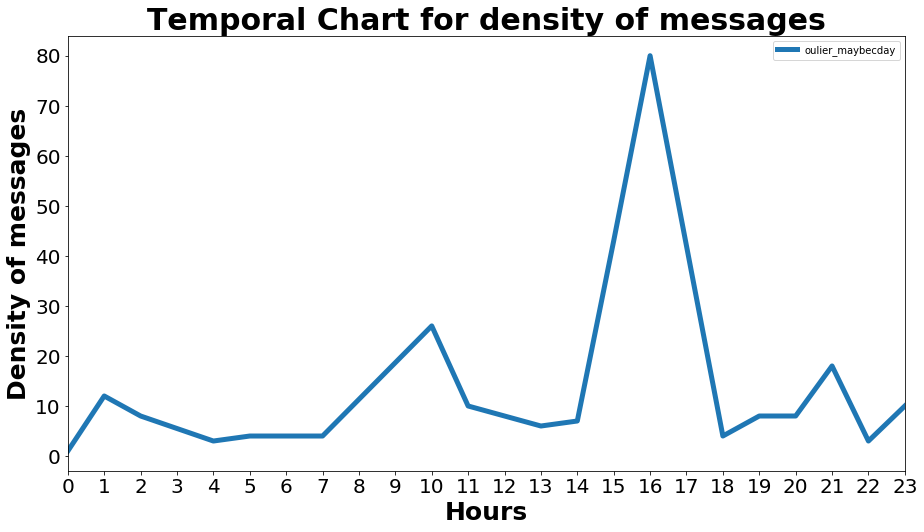

In [21]:
# Temporal chart for density of messages

timedata.plot(figsize=(15,8), linewidth=5, fontsize=20)
plt.xticks(range(24))
plt.xlabel('Hours',fontsize=25,fontweight='bold')
plt.ylabel('Density of messages',fontsize=25,fontweight='bold')
plt.title('Temporal Chart for density of messages',fontsize=30,fontweight='bold')

## 5. Concept drift to find if there is any drift in data

We are not getting any concept drift on this port as the message density on this port is very sparse.

In [24]:
# Converting the event time column to date and time format
oulier_maybecday['event_time'] = pd.to_datetime(oulier_maybecday['event_time'])
timedata = oulier_maybecday['event_time']
timedata = pd.to_datetime(timedata)

from skmultiflow.classification.core.driftdetection.adwin import ADWIN
adwin = ADWIN()
data_stream = timedata

for i in range(2000):
    adwin.add_element(data_stream[i])
    if adwin.detected_change():
        print('Change has been detected in data: ' + str(data_stream[i]) + ' - of index: ' + str(i))

## 6. Clustering the ports based on message density using DBSCAN

We are clustering the all the ports based on different message density and we are catagorizing each ports based on traffic by grouping them into similar colors(labels) showen below.
<br>
Note:-  There will be only 14 different ports that has AIS message and rest of the ports has 0 message density tus we are not showing them on the plot. Because we already know these ports belong to one cluster.

In [24]:
# Using one hot encoding to encode each port data
port_data = pd.get_dummies(eachPortDensity, columns=['index'], prefix = ['index'])

In [25]:
from sklearn.cluster import DBSCAN
dbscan = DBSCAN(eps=100,min_samples=1).fit(port_data)

In [28]:
labels = dbscan.labels_
array = np.array(labels)
eachPortDensity['labels'] = array

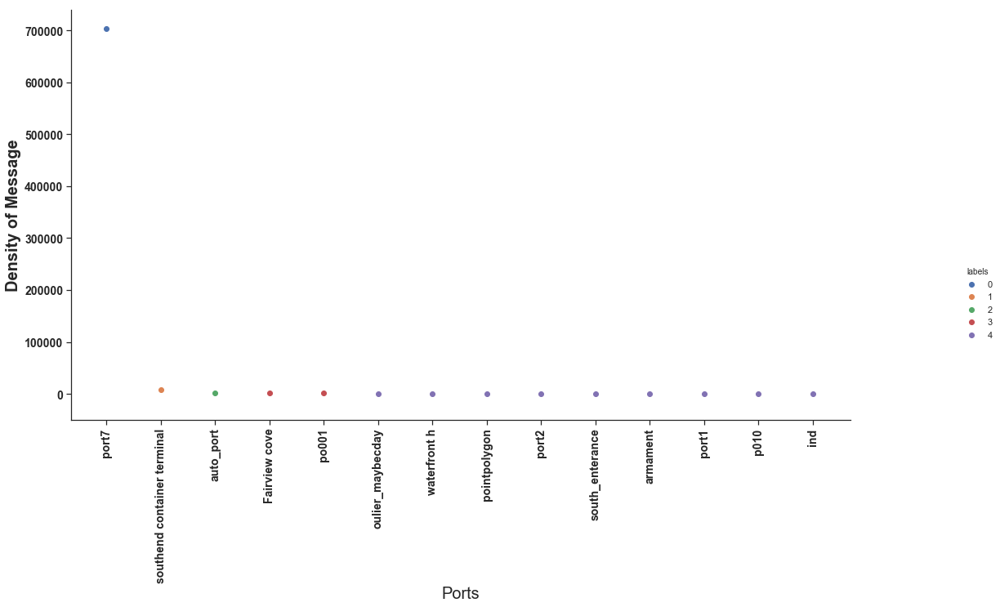

In [30]:
sns.set(style='ticks')
_labels=[0,  1,  2,  3,  4]
fg = sns.FacetGrid(data=eachPortDensity, hue='labels', hue_order=_labels, aspect=1.61)
fg.map(plt.scatter,'index','index_right').add_legend()
fg.set_xticklabels(rotation=90)
plt.xlabel('Ports',fontsize=20)
plt.ylabel('Density of Message',fontsize=20,fontweight='bold')
#plt.title('Temporal Chart for density of messages',fontsize=30,fontweight='bold')
fig = plt.gcf()
fontsize = 14
ax = plt.gca()
for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
    tick.label1.set_fontweight('bold')
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
    tick.label1.set_fontweight('bold')
fig.set_size_inches(20, 10)

## References

[1] "skmultiflow.classification.core.driftdetection.adwin module — scikit-multiflow 0.1.0 documentation", Scikit-multiflow.github.io, 2019. [Online]. Available: https://scikit-multiflow.github.io/scikit-multiflow/skmultiflow.classification.core.driftdetection.adwin.html. [Accessed: 06- Aug- 2019].
<br>
[2]"Module: color — skimage v0.16.dev0 docs", Scikit-image.org, 2019. [Online]. Available: https://scikit-image.org/docs/dev/api/skimage.color.html. [Accessed: 06- Aug- 2019].
<br>
[3]D. header? and G. Ranjan, "Dataframe has no column names. How to add a header?", Data Science Stack Exchange, 2019. [Online]. Available: https://datascience.stackexchange.com/questions/45314/dataframe-has-no-column-names-how-to-add-a-header. [Accessed: 06- Aug- 2019].
<br>
[4]M. Rocklin, "Streaming Dataframes", Matthewrocklin.com, 2019. [Online]. Available: https://matthewrocklin.com/blog/work/2017/10/16/streaming-dataframes-1. [Accessed: 06- Aug- 2019].
<br>
[5]M. plot), M. Ebersole, A. Martin and G. Kroot, "Matplotlib animation not working in IPython Notebook (blank plot)", Stack Overflow, 2019. [Online]. Available: https://stackoverflow.com/questions/25333732/matplotlib-animation-not-working-in-ipython-notebook-blank-plot. [Accessed: 06- Aug- 2019].
<br>
[6]"scikit-learn: machine learning in Python — scikit-learn 0.21.3 documentation", Scikit-learn.org, 2019. [Online]. Available: https://scikit-learn.org/stable/. [Accessed: 06- Aug- 2019].
<br>
[7] Content referred from Lab 5 of CSCI 5901 by Mohammad Etemad
<br>
[8] Content referred from Lab 7 of CSCI 5901 by Mohammad Etemad
<br>
[9] Help from teaching assistant(Mohammad Etemad)